# Examples of users using the `PDEsolver` package
This part aims to act as a user of using the package PDEsolver, and to solve various different kind of PDEs.

------
## Import necessary packages

In [1]:
import PDEsolver as pde
import numpy as np
from scipy.integrate import solve_ivp

----
## User 0: 
Find the change of the Gaussian function <font size= "4">$u = \frac{\sigma}{\sqrt{\sigma^2+2Dt}}e^{-\frac{x^2}{2(\sigma^2+2Dt)}}$</font> after 10 seconds when *i) advecting at v = 0.5* and *ii) diffusing at D = 0.5*. 

### *i) Advection Only*

In [2]:
# Define Parameters
grid_gauss = pde.create_grid(10*np.pi,512)  # Spatial domain
x_gauss = grid_gauss.x
t_gauss = pde.time_domain(10,0.1)           # Time domain

v_ao = 0.5                                  # Advection velocity
D_ao = 0.0                                  # No diffusion

# Initial condition
def gaussian_solution(t, x, σ, D): 
    '''
    This is a function that returns the Gaussian solution at time = t, domain = x, initial width of the curve = σ, and diffusivity = D.
    '''
    return σ / np.sqrt(σ**2 + 2*D*t) * np.exp(-x**2 / (2*(σ**2 + 2*D*t)))

u0_gauss = gaussian_solution(0,x_gauss,0.8,0)

In [3]:
# Calculate the solution
numerical_sol_ao  = solve_ivp(pde.adv_diff_eq,[t_gauss[0],t_gauss[-1]],u0_gauss,args=(grid_gauss,D_ao,v_ao),t_eval=t_gauss,method='DOP853')
pde.plot_anim(t_gauss,grid_gauss,u0_gauss,numerical_sol_ao)

### *ii) Diffusion Only*

In [4]:
# Define parameters
v_do = 0.0                               # No advection
D_do = 0.5                               # Diffusion rate

In [5]:
# Calculate the solution
numerical_sol_do = solve_ivp(pde.adv_diff_eq,[t_gauss[0],t_gauss[-1]],u0_gauss,args=(grid_gauss,D_do,v_do),t_eval=t_gauss,method='DOP853')
pde.plot_anim(t_gauss,grid_gauss,u0_gauss,numerical_sol_do)

> **Comment:**  
> The left plot shows the initial state and final state of the signal. The right plot shows the animation of the signal travelling to the right and diffusing as it travels. **User 0** has demonstrated the successful representation of advection and diffusion of the signal, which indicates the correct calculation of the advection-diffusion equation solution using the pseudo-spectral method by `PDEsolver`.

-----
## User 1: 
Find the signal of $u_0(x) = \frac{1}{cosh^2(x)}$ for $x \in [-16,16]$ after 10 seconds when the wave is simply advecting and diffusing based on the advection-diffusion equation. The advection velocity equals to 0.6 and diffusion rate equals to 0.3.

In [6]:
# Define the time domain with t_final = 10 and dt = 0.1 (a random pick)
t_1 = pde.time_domain(10, 0.1)

# Define the spatial domain using the grid class
grid_1 = pde.create_grid(32,512)
x_1 = grid_1.x

# Define initial condition
u0_1 = 1/np.cosh(x_1)**2

# Define the values for coefficients
D_1 = 0.3        # diffusion rate
v_1 = 0.6        # advection velocity

In [7]:
u_1 = solve_ivp(pde.adv_diff_eq,[t_1[0],t_1[-1]],u0_1,args=(grid_1,D_1,v_1),t_eval = t_1,method = 'DOP853')
pde.plot_anim(t_1,grid_1,u0_1,u_1)

> **Comment:**  
> This is a successful approximation of the advection-diffusion equation solution.

-----
## User 2: 
Basic conditions no change. Now, the wave is travelling based on the Burger's equation. Find the signal after 10 seconds.

In [8]:
u_2 = solve_ivp(pde.burger_eq,[t_1[0],t_1[-1]],u0_1,args=(grid_1,D_1),t_eval = t_1,method = 'DOP853')
pde.plot_anim(t_1,grid_1,u0_1,u_2)

> **Comment:**  
> This example shows the diffusing Burger's wave, which is a correct approximation as shown by the plots.

---
## User 3: 
Wants to create a new PDE and use the PDEsolver to solve it. The new PDE is: <font size= "3">$\frac{\partial u}{\partial t} = 0.07\frac{\partial^3 u}{\partial x^3} + 1.5\frac{\partial u}{\partial x}$</font>. Find the solution of the PDE after 10 seconds for $x \in [-32,32]$ and the initial condition is $u_0 = e^{-x^2}$.

In [9]:
# Spatial and Temporal domains are the same as above
# Define Initial conditions
grid_3 = pde.create_grid(64,1024)
x_3 = grid_3.x
u0_3 = np.exp(-x_3**2)

# Define the new PDE using the pseudo-spectral method
def new_PDE(t,u,grid):
    '''
    This is a randomly produced new PDE with no specific meaning but to test the usefulness of the PDEsolver package.
    '''
    d_u = pde.derivative(grid,u,1)
    ddd_u = pde.derivative(grid,u,3)
    
    du_dt = 0.07*ddd_u + 1.5*d_u
    
    return du_dt

In [10]:
# Solve the new PDE
u_3 = solve_ivp(new_PDE,[t_1[0],t_1[-1]],u0_3,args=(grid_3,),t_eval = t_1, method = 'DOP853')
pde.plot_anim(t_1,grid_3,u0_3,u_3)

> **Comment:**  
> The wave created by this new PDE moves to the left and the wave is smooth. **User 3** demonstrates the possibility of using `PDEsolver` to solve PDEs created by your own.

----
## User 4:
Find the signal of $u_0(x) = \frac{1}{cosh^2(x)}$ for $x \in [-16,16]$ after 10 seconds when the wave is travelling based on the Burger's Equation with almost no diffusion ($D = 0.01$).

In [11]:
# Almost no diffusion of Burger's Equation
D_4 = 0.01
u_4 = solve_ivp(pde.burger_eq,[t_1[0],t_1[-1]],u0_1,args=(grid_1,D_4),t_eval = t_1,method = 'DOP853')
pde.plot_anim(t_1,grid_1,u0_1,u_4)

> **Comment:**  
> Because of the very small diffusion rate, the Burger's wave tends to create a shock wave. This creates some error in the calculation, leading to the noise demonstrated in the right plot animation.

----
## User 5:
Wants to improve the error occured as shown by **User 4**. Therefore, **User 5** tries another temporal integration method called 'LSODA'. 

In [12]:
# Same parameters but change the integration method
u_5 = solve_ivp(pde.burger_eq,[t_1[0],t_1[-1]],u0_1,args=(grid_1,D_4),t_eval = t_1,method = 'LSODA')
pde.plot_anim(t_1,grid_1,u0_1,u_5)

>**Comment:**  
> This new integration method, "LSODA", has improved the noise problem in the temporal integration calculation. **User 5** has demonstrated the importance of integration method selection when finding the PDE solutions.

----
## User 6:
Has acknowledged the importance of **initial condition** selection in PDE solving. **User 6** decided to use the extreme choice of a negative sine function $u_0 = -\sin(\frac{2\pi x}{32})$ travelling as Burger's equation in the domain to see how the `PDEsolver` performs. This initial condition tends to create a shock wave at x = 0 with the Burger's equation.

In [13]:
import timeit

### *i) D = 0.01 and method = 'DOP853'*

In [14]:
# Initial condition easy to break
u0_6 = -np.sin(2*np.pi*x_1/32)
start = timeit.default_timer()
u_6i = solve_ivp(pde.burger_eq,[t_1[0],t_1[-1]],u0_6,args=(grid_1,D_4),t_eval = t_1,method = 'DOP853')
end = timeit.default_timer()
print('The operation time is {:.3f} seconds.'.format(end-start))
pde.plot_anim(t_1,grid_1,u0_6,u_6i)

The operation time is 0.191 seconds.
Sorry, there is something wrong with the parameter value or initial condition selection.


### *ii) D = 0.02 and method = 'DOP853'*

In [15]:
# Increase the diffusivity little
D_6ii = 0.02
start = timeit.default_timer()
u_6ii = solve_ivp(pde.burger_eq,[t_1[0],t_1[-1]],u0_6,args=(grid_1,D_6ii),t_eval = t_1,method = 'DOP853')
end = timeit.default_timer()
print('The operation time is {:.3f} seconds.'.format(end-start))
pde.plot_anim(t_1,grid_1,u0_6,u_6ii)

The operation time is 0.169 seconds.


### *iii) D = 0.02 and method = 'LSODA'*

In [16]:
# Change the integration method from DOP853 to LSODA
start = timeit.default_timer()
u_6iii = solve_ivp(pde.burger_eq,[t_1[0],t_1[-1]],u0_6,args=(grid_1,D_6ii),t_eval = t_1,method = 'LSODA')
end = timeit.default_timer()
print('The operation time is {:.3f} seconds.'.format(end-start))
pde.plot_anim(t_1,grid_1,u0_6,u_6iii)

The operation time is 0.588 seconds.


> **Comment:**  
> **User 6** demonstrates the importance of choices of initial condition and parameters. *(i)* shows the inability to solve the PDE with extreme initial condition with extreme diffusivity. *(ii)* shows the `PDEsolver` could solve the PDE, but with large amount of noise in the solution. *(iii)* shows the better solution with less noise. Now, the solution does not break, but with 3 times of the operation time. The trigonometry functions are typically not suitable for acting as initial conditions when using the `PDEsolver` to solve the PDE. This is because the Fourier transform component involved in the spatial derivative calculation. In addition, the temporal integration method would also affect the final PDE solution.

## User 7:
Has also acknowledge the importance of initial condition selection in solving PDEs. Fourier transform tends to create error at the boundary of the physical domain. So, **User 7** wants to use the **cosine function** to test how bad it is when the cosine function is the initial condition. The cosine function travels based on the Advection-diffusion equation with D = 0.3 and v = 0.6.

In [25]:
# Initial condition = cos(x)
u0_7 = np.cos(x_1)
u_7 = solve_ivp(pde.adv_diff_eq,[t_1[0],t_1[-1]],u0_7,args=(grid_1,D_1,v_1),t_eval = t_1,method = 'DOP853')
pde.plot_anim(t_1,grid_1,u0_7,u_7)

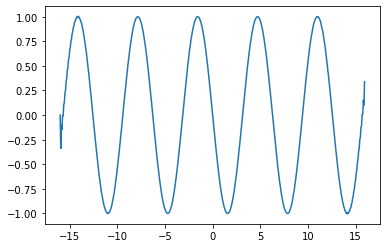

In [27]:
# Check the performance of derivative purely
d = pde.derivative(grid_1,u0_7,1)

import matplotlib.pyplot as plt
plt.plot(x_1,d)
plt.show()

> **Comment:**  
> In the advection-diffusion equation solution plots, the solutions are represented smoothly and there is superposition of signals at the most negative part of the domain. This is because of the periodic boundary condition assumed by the pseudo-spectral method.  
> In the derivative plot, there clearly exists error at the two ends of the wave. This is the common error caused by Fourier transform. 

--- 
## Conclusion
When using the `PDEsolver` module to solve PDEs in comination with the `scipy.integrate.solve_ivp`, there are few points that need careful consideration:
- Initial condition
- Parameter values
- Method of temporal integrations

For more performance evaluations, please refer to the [Project_error_evaluation.ipynb](Project_error_evaluation.ipynb).